## Evaluation

In [1]:
from rasterio.warp import reproject, Resampling, calculate_default_transform
import rasterio as rio
import geopandas as gpd
import pandas as pd
import os
from shapely import wkt
from shapely.geometry import box
import leafmap.foliumap as leafmap
import folium
import rioxarray as rioxr
import matplotlib.pyplot as plt
import numpy as np
import osmnx as ox
from skimage import io
import xarray as xr
import shapely
from typing import Any, Union, Dict, List
import seaborn as sns

In [2]:
import torch
import torch.nn as nn

In [3]:
import changeos
from src.modelling.cva import CVA
import cv2
from src.modelling.utils import otsu

In [4]:
# Models
from src.modelling.unet import Unet
from src.modelling.siamunet_conc import SiamUnet_conc
from src.modelling.siamunet_diff import SiamUnet_diff
from src.modelling.fresunet import FresUNet

In [5]:
from shapely.geometry import shape as geo_shape
from rasterio.features import shapes as rio_shapes
from rasterio import features
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import  watershed
from pathlib import Path
from tqdm import tqdm
from abc import ABC, abstractmethod
from skimage.transform import resize
from shapely import box
from sklearn.metrics import precision_score, recall_score, roc_auc_score, auc, cohen_kappa_score , average_precision_score, f1_score
import pprint as pp

In [6]:
pd.options.display.max_columns = 50

In [7]:
from src.config import *
from src.io.utils_io import load_maxar_items, load_rs_path_toy, load_roi_town, check_dir, make_path, save_pickle
from src.stac.utils_stac import get_nearest_match_geometry_view
from src.utils import create_bbox, get_maxar_items_on_roi
from src.rs_processing.processing import crop_rs_on_shape, rasterize_shp
from src.io.utils_io import load_pair_raster,make_path,load_pickle
from src.data.urban_area import extract_urban_area

In [8]:
CRS = 32629
s_buffer = 157

In [9]:
urban_area = load_pickle(make_path("urban_area.pkl", processed_dir_path, "dataset"))

In [10]:
test_set= load_pickle(make_path("dataset_labelled_test_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

In [11]:
dataset = load_pickle(make_path("dataset_visual_157.pkl", processed_dir_path, "dataset", "png"))

In [12]:
dataset_labelled = load_pickle(make_path("dataset_labelled.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

In [13]:
dataset_labelled.shape

(29, 5)

In [14]:
dataset_labelled.columns

Index(['annotation_id', 'labels_path', 'img_id', 'after_path', 'before_path'], dtype='object')

In [14]:
def sigmoid(x):
 return 1/(1 + np.exp(-x))
    
def postprocess_siam(output: np.ndarray): 
    output = output.detach().numpy()
    output = np.max(output, axis=1)
    output = output.squeeze(0)
    output = sigmoid(output)
    output = (1 - output)
    return output

def preprocess_siam(pre_img: np.ndarray, post_img: np.ndarray): 
    
    pre_img = torch.from_numpy(pre_img.transpose(2, 0, 1)).float().unsqueeze(0)
    post_img = torch.from_numpy(post_img.transpose(2, 0, 1)).float().unsqueeze(0)

    return pre_img, post_img

def postprocess_changeos(output: np.ndarray): 
    loc, dam = output
    output = np.where(dam > 1, 1., 0.)
    return output

def preprocess_cva(pre_img: np.ndarray, post_img: np.ndarray):
    k_blur = 5
    pre_img = cv2.GaussianBlur(pre_img, (k_blur,k_blur),0)
    post_img = cv2.GaussianBlur(post_img, (k_blur,k_blur),0)

    # cva imp is waiting (c,h, w)
    pre_img = pre_img.transpose(2, 0, 1)
    post_img = post_img.transpose(2, 0, 1)

    return pre_img, post_img

def postprocess_cva(output: np.ndarray): 
    
    img_height, img_width = output.shape

    bcm = np.zeros((img_height, img_width))
    thre = otsu(output.reshape(1, -1))
    bcm[output > thre] = 255    
    return bcm

In [15]:
def predict_siam(model, pre_img, post_img): 
    pass

In [16]:
def load_pt_model(dict_model): 
    
    path = dict_model["path"]
    args = dict_model["input"]
    
    model = dict_model["model"](*args)
    
    model.load_state_dict(torch.load(path))
    model.eval()
    return model

def load_changeos(dict_model): 
    
    model = changeos.from_name(dict_model["model"])
    return model

def load_sfa():
    pass



In [17]:
def init_models_entry():
    models_entry = {
                "Unet":
                {
                    "path":"", 
                    "model":Unet,
                    "input":(2*3, 2), 
                    "builder": load_pt_model,
                    "predictor":predict_siam, 
                    "postprocess":postprocess_siam, 
                    "preprocess":preprocess_siam

                },
                "FC-Siam-conc":
                {
                    "path":"", 
                    "model":SiamUnet_conc,  
                    "input":(3, 2),
                    "builder": load_pt_model,
                    "predictor":predict_siam, 
                    "postprocess":postprocess_siam, 
                    "preprocess":preprocess_siam

                },
                "FC-Siam-diff":
                {
                    "path":"", 
                    "model":SiamUnet_diff,  
                    "input":(3, 2), 
                    "builder": load_pt_model,
                    "predictor":predict_siam,
                    "postprocess":postprocess_siam, 
                    "preprocess":preprocess_siam
    
                }, 
                "FresUNet":
                {
                    "path":"",
                    "model":FresUNet,  
                    "input":(2*3, 2),
                    "builder": load_pt_model,
                    "predictor":predict_siam,
                    "postprocess":postprocess_siam, 
                    "preprocess":preprocess_siam

                }, 
                "changeos": 
                {
                    "path":"",
                    "model":'changeos_r18',  
                    "input":None,
                    "builder": load_changeos,
                    "predictor":None, 
                    "postprocess":postprocess_changeos, 
                    "preprocess":None

                },
                "cva": 
                {
                    "path":"",
                    "model":CVA,  
                    "input":None,
                    "builder": None, 
                    "predictor":None, 
                    "postprocess":postprocess_cva, 
                    "preprocess":preprocess_cva
                },
                "sfa": 
                {
                    "path":"",
                    "model":None,  
                    "input":None,
                    "builder": load_sfa, 
                    "predictor":None
                }
            }
    return models_entry


In [18]:
class ModelFactory:
    def __init__(self):
        self.models_entry = models_entry

    def load(self, model_key: str, *args): 

        dict_model = {k:v for k,v in self.models_entry[model_key].items() if k!="builder"}
        builder = self.models_entry[model_key].get("builder", None) 

        if builder: 
            return builder(dict_model)

        return self.models_entry[model_key]["model"]

    def predict(self, model_key: str, *args): 
        """
        not used
        """

        dict_model = {k:v for k,v in self.models_entry[model_key].items() if k!="predictor"}
        predictor = self.models_entry[model_key]["predictor"]

        return predictor(dict_model)
    

In [19]:
class InferenceModel:
    def __init__(self, model_entry, model_name, model=None): 
        self.model_entry = model_entry
        
        if model_name is None and model is None: 
            raise ValueError("Please provide a least model_name or (model, model_name)")
        
        self.model_name = model_name
        self.model = self.init_model(model_name, model)
            
    def init_model(self, model_name, model):
        if model is None:
            return ModelFactory().load(model_name)
        else: 
            return model

    def postprocessing(self, out):
        if self.model_entry.get("postprocess"): 
            return self.model_entry.get("postprocess")(out)
        return out

    def preprocessing(self, pre_img, post_img):
        if self.model_entry.get("preprocess"):
            return self.model_entry.get("preprocess")(pre_img, post_img)
        return pre_img, post_img
        
    def predict(self, pre_path=None, post_path=None): 

        pre_img = io.imread(pre_path)
        post_img = io.imread(post_path)
        
        pre_img, post_img = self.preprocessing(pre_img, post_img)
        output =  self.model(pre_img, post_img)
        output = self.postprocessing(output)

        return output

In [31]:
dataset.columns

Index(['before_path', 'after_path', 'town_name', 'geometry', 'quadkey',
       'before_href', 'before_view_off_nadir', 'before_view_azimuth',
       'before_view_incidence_angle', 'before_view_sun_azimuth',
       'before_view_sun_elevation', 'before_platform', 'before_clouds_percent',
       'after_href', 'after_view_off_nadir', 'after_view_azimuth',
       'after_view_incidence_angle', 'after_view_sun_azimuth',
       'after_view_sun_elevation', 'after_platform', 'after_clouds_percent',
       'id_pair', 'diff_view_off_nadir', 'diff_view_incidence',
       'diff_view_sun_azimuth', 'diff_avg', 'before_path_png',
       'after_path_png', 'img_id', 'urban_area_path'],
      dtype='object')

In [32]:
def inference_on_sample(sample: pd.Series, model_name = "FC-Siam-diff"):    
    (
        b_path, 
        a_path, 
        img_id
    )= (
        sample["before_path"], 
        sample["after_path"], 
        sample["img_id"]
    )


    model_entry = models_entry[model_name]
    
    output = InferenceModel(model_entry, model_name).predict(b_path, a_path)

    return output

In [20]:
MODELS_VERSION = {
    "Unet": {
        #"1": make_path("model_Unet_augm_default_sb32_sp96_st0.2_ep20", models_dir_path)
        "1": make_path("model_Unet_augm_default_sb32_sp96_st0.2_ep15", models_dir_path)
    },
    "FC-Siam-diff": {
        #"1": make_path("model_FC-Siam-diff_augm_default_sb32_sp96_st0.2_ep20", models_dir_path),
        "1": make_path("model_FC-Siam-diff_augm_default_sb32_sp96_st0.2_ep15", models_dir_path),
        
    },
    "FC-Siam-conc":{
        #"1": make_path("model_FC-Siam-conc_augm_default_sb32_sp96_st0.2_ep20", models_dir_path)
        "1": make_path("model_FC-Siam-conc_augm_default_sb32_sp96_st0.2_ep15", models_dir_path)
    }, 
    "FresUNet":{
        #"1": make_path("model_FresUNet_augm_default_sb32_sp96_st0.2_ep20", models_dir_path)
        "1": make_path("model_FresUNet_augm_default_sb32_sp96_st0.2_ep15", models_dir_path)
    }, 
    "changeos":{
        "1":None
    }, 
    "cva":{
        "1":None
    }
}

## Inference on sample

In [25]:
dataset_labelled.sample().img_id.item()

'2c9db706-33a8-410a-9ea0-cc31bc7a1d52'

img_test = 29

In [60]:
len(dataset_labelled)

29

In [363]:
img_id = dataset_labelled.sample().img_id.item()
sample = dataset_labelled[dataset_labelled.img_id == img_id]

In [364]:
sample = sample.squeeze()

In [365]:
sample["labels_path"]

'/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/extra/labels/task-34-annotation-30-by-1-tag-damage_building-0.png'

In [366]:
models_entry = init_models_entry()
model_name = "FresUNet"
version = "1"

models_entry[model_name]["path"] = MODELS_VERSION[model_name][version]

output = inference_on_sample(sample, model_name=model_name)

In [367]:
output.shape

(1024, 1024)

(-0.5, 1023.5, 1023.5, -0.5)

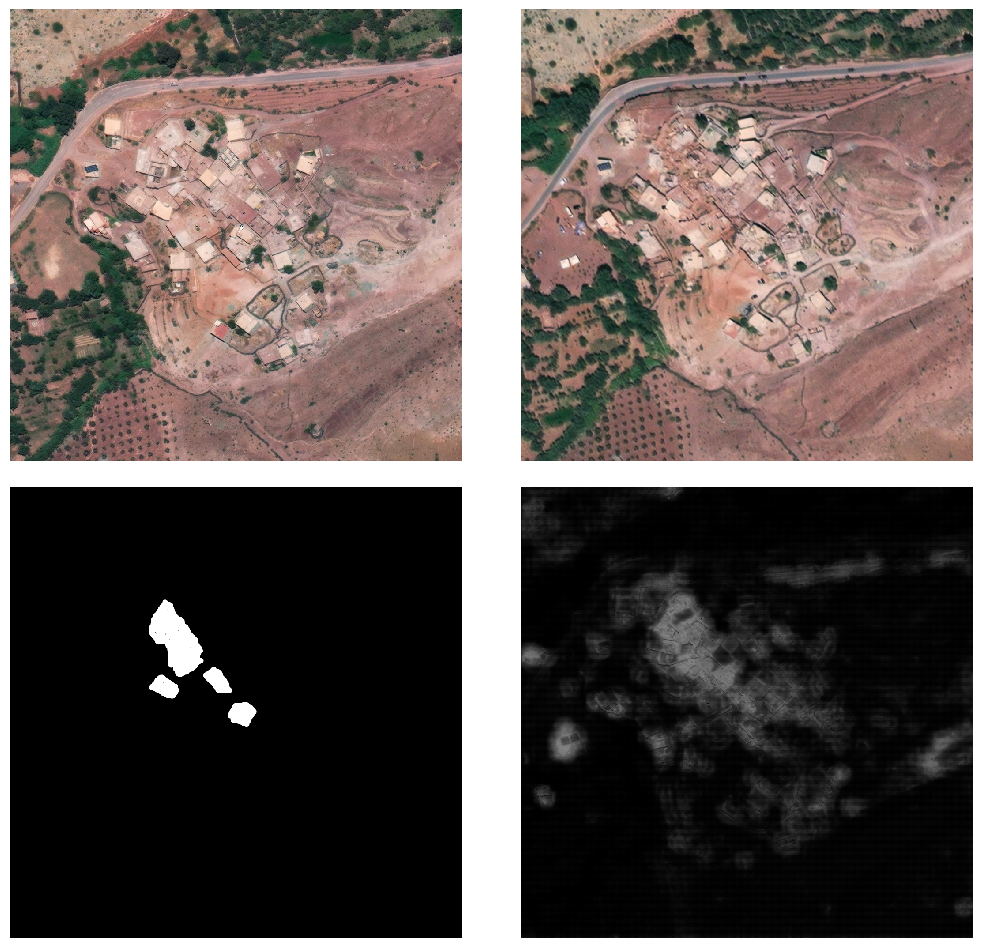

In [374]:
(
    b_path, 
    a_path, 
    label, 
    img_id
)= (
    sample["before_path"], 
    sample["after_path"], 
    sample["labels_path"], 
    sample["img_id"]
)
plt.figure(figsize=(10, 10))
plt.subplot(2, 2, 1)
io.imshow(b_path)
plt.axis("off")
plt.subplot(2, 2, 2)
io.imshow(a_path)
plt.axis("off")
plt.subplot(2, 2, 3)
io.imshow(label)
plt.axis("off")
plt.subplot(2, 2, 4)
io.imshow( output)
plt.axis("off")

In [317]:
sample.img_id

'3d2355ab-f7b9-4e01-8cb0-0926b0158fd6'

In [34]:
np.unique(output)

array([0.])

# Evaluation

In [16]:
import h3pandas as h3
from rasterstats import zonal_stats
from typing import Tuple
import geoplot as gplt
import geoplot.crs as gcrs

In [17]:
def processing_pred_eval(output): 
    #output =  resize(output,(1024, 1024), anti_aliasing=True, preserve_range=True)
    #output = (1 - output)

    return output

def processing_label_eval(label_path: str): 
    arr_label = None
    if isinstance(label_path, str):
        arr_label = io.imread(label_path)
        arr_label =  resize(arr_label,(1024, 1024), anti_aliasing=True, preserve_range=True)
        arr_label =  np.where(arr_label > 0, 1, 0)

    return arr_label

In [18]:
def show_items_from_id(img_id: str, dataset): 
    sample = dataset[dataset.img_id == img_id].squeeze()
    a_path, b_path, label_path = sample["a_path"], sample["b_path"], row["label_path"]
    
    plt.figure(figsize=(20, 8))
    
    plt.subplots(1, 3, 1)
    io.imshow(b_path)
    plt.axis("off")
    
    plt.subplots(1, 3, 1)
    io.imshow(a_path)
    plt.axis("off")
    
    plt.subplots(1, 3, 1)
    io.imshow(label_path)
    plt.axis("off")

In [19]:
def get_raster_stats_on_poly(urban: gpd.GeoDataFrame, rs: xr.DataArray) -> gpd.GeoDataFrame: 
    arr = rs.sel(band=1).data

    zs = zonal_stats(urban, 
                     arr, 
                     affine=rs.rio.transform(), 
                     stats=['count', 'mean', "max",'median', 'majority', 'sum'])
    
    zs = pd.DataFrame(zs)
    urban_zs = pd.concat([urban, zs], axis=1)
    urban_zs["sum"] = urban_zs["sum"].fillna(0)
    urban_zs["sum"] = shift_range_values(urban_zs["sum"])

    return urban_zs

def mask_array_to_geotiff(arr, rs_path_src: str, out_path: str):
    with rio.open(rs_path_src, "r") as rs_src: 
        meta = rs_src.meta.copy()
        meta.update(
            {
                "driver": "GTiff", 
                'count': 1, 
                'dtype': 'float32'
            })
        with rio.open(out_path, "w", **meta) as dest:
            dest.write_band(1,arr)
    return out_path
    
def shift_range_values(arr, new_bounds=[0, 1]): 
    old_range = (np.max(arr) - np.min(arr))  
    new_range = (new_bounds[1] - new_bounds[0])  
    shit_arr = (((arr - np.min(arr)) * new_range) / old_range) + new_bounds[0]
    return shit_arr

In [20]:
def get_classification_metrics(urban_zs_label, urban_zs_pred, th_true=0, plot=True):
    
    def _get_metrics_plot(metrics, names: List[str], plot:bool):
        metrics = metrics[names+["th"]]
        metrics = metrics.melt(id_vars="th", var_name="metric", value_name="score")
        fig = sns.lineplot(data=metrics, x="th", y="score", hue="metric")
        plt.title("Classification metrics based on decision threshold")
        return fig 

    def get_max_metrics(metrics, names): 
        max_metrics = {}
        #metrics.set_index("th")
        for m in names:
            max_metrics[m] = metrics[m].max()
        return max_metrics 

    metrics = []
    true_labels = (urban_zs_label["sum"] > th_true).astype(int).values    
    #print(f"Support : {(urban_zs_label['sum'] > th_true).astype(int).value_counts()}")
    
    for th in np.arange(0, 1, 0.02): 
        pred = (urban_zs_pred["sum"] > th).astype(int).values 
    
        metrics.append({
            "th":th,
            "precision": precision_score(true_labels, pred), 
            "recall": recall_score(true_labels, pred), 
            "f1_score": f1_score(true_labels, pred),
            "kappa_score":cohen_kappa_score(true_labels, pred), 
            "roc_auc_score": roc_auc_score(true_labels, pred) if len(np.unique(true_labels)) > 1 else np.nan,
            "AP": average_precision_score(true_labels, pred),
        })
        
    metrics = pd.DataFrame(metrics)
    
    plot_metrics = ["precision", "recall", "f1_score"]
    max_metrics = ["kappa_score", "roc_auc_score", "AP"]

    
    fig = _get_metrics_plot(metrics, plot_metrics, plot)

    max_metrics = get_max_metrics(metrics, max_metrics)
    #print("Global metric (max)")
    #pp.pprint(max_metrics)
    #print('----')

    
    return dict(metrics=metrics, fig=fig, max_metrics=max_metrics)


In [21]:
def visualize_damage_map_agg(urban_zs_pred, 
                         bounds: Tuple[float], 
                         urban_zs_label=None, 
                         img_id=None,
                        visualize:str=None):

    x_min, y_min, x_max, y_max = bounds
    background = gpd.GeoDataFrame(geometry=[box(x_min, y_min, x_max, y_max)], crs=urban_zs_label.crs)

    if urban_zs_label is None:
        fig, axes = plt.subplots(1, 1, figsize=(15, 6))
        urban_zs_label.plot(column='sum',cmap="RdBu_r", legend=True, figsize=(15, 5), legend_kwds={"shrink":.5}, ax=axes)
        plt.axis("off")
        plt.title(f"Damages map for {img_id}" if img_id else "Damages map")
        background.plot(color="grey", zorder=0, ax=axes)

    else:
        fig, axes = plt.subplots(1, 2, figsize=(18, 8))
        urban_zs_label.plot(column='sum', cmap="RdBu_r", legend=True, ax=axes[0], legend_kwds={"shrink":.5})
        axes[0].set_axis_off()
        axes[0].set_title(f"True damages map for {img_id}" if img_id else "True damages map")
        background.plot(ax=axes[0], color="grey", zorder=0)


        urban_zs_pred.plot(column='sum',cmap="RdBu_r", legend=True, ax=axes[1], legend_kwds={"shrink":.5})
        axes[1].set_axis_off()
        axes[1].set_title(f"Predicted damages map for {img_id}" if img_id else "Predicted damages map")
        background.plot(ax=axes[1], color="grey", zorder=0)

        return fig


In [22]:
def check_label(label_path, rs_path=None): 
    if isinstance(label_path, str):
        return label_path
    if rs_path is None:
        raise ValueError("Please provide rs_path for create empty label")
    # not efficient lot of io operations - change in memory ?
    dummy_path = "tmp.png"
    rs_ref = rioxr.open_rasterio(rs_path)
    size = rs_ref.data.shape[-2:]
    data_nodamage = np.zeros(size, dtype=np.uint8)
    io.imsave(dummy_path, data_nodamage)
    return dummy_path

In [23]:
def eval_on_sample(output: np.ndarray, label_path:str, a_path: str, img_id: str,  urban_path: str, visualize=True) -> pd.DataFrame:

    label_path = check_label(label_path, a_path)
    
    pred = processing_pred_eval(output)
    label = processing_label_eval(label_path)

    urban = gpd.read_file(urban_path)
    urban = (
        urban
        .drop_duplicates("geometry")
        .dropna(subset=["geometry"])
        .reset_index(drop=True)
    )

    viz_name = Path(urban_path).stem
    
    # change io operation path or remove files
    rs_pred_path = mask_array_to_geotiff(pred, rs_path_src=a_path, out_path="out_test_pred.tif")
    rs_label_path = mask_array_to_geotiff(label, rs_path_src=a_path, out_path="out_test_label.tif")


    rs_pred = rioxr.open_rasterio(rs_pred_path)
    rs_label = rioxr.open_rasterio(rs_label_path)


    urban_zs_pred = get_raster_stats_on_poly(urban, rs_pred)
    urban_zs_label = get_raster_stats_on_poly(urban, rs_label)


    metrics = get_classification_metrics(urban_zs_label, 
                         urban_zs_pred, 
                         plot=visualize)

            
    fig_agg_dm = visualize_damage_map_agg(urban_zs_pred=urban_zs_pred,
                         bounds=rs_pred.rio.bounds(),
                         urban_zs_label=urban_zs_label, 
                         img_id=img_id,
                         visualize=visualize)



    return dict(
        metrics=metrics, 
        urban_pred=urban_zs_pred, 
        urban_label=urban_zs_label, 
        plots=dict(dm_agg=fig_agg_dm) 
    )

== hex 12 - 7 ==


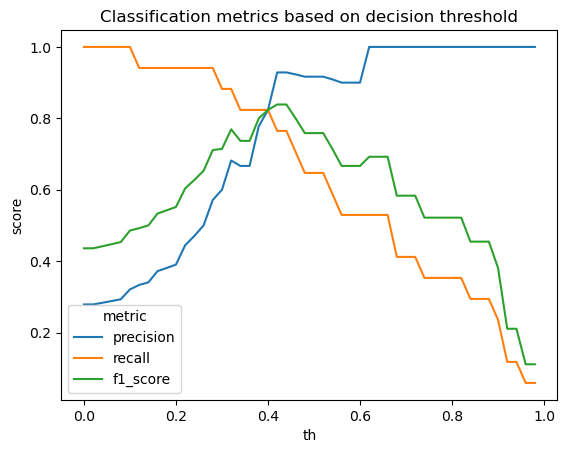

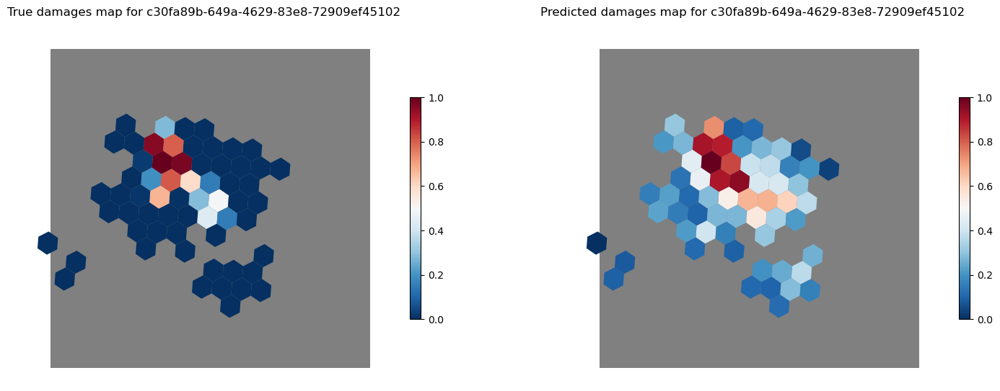

In [371]:
img_id = sample.img_id


#urban_path = urban_area.loc[urban_area.img_id == img_id, "urban_area_path"].item()

s_buffer = 157
save= True
method = "osm_buffer"
fill_holes=True
resolution=12
building_buffer=7

town_name, loc, b_rs_path, a_rs_path = dataset.loc[dataset.img_id == sample.img_id, ["town_name", "geometry", "before_path", "after_path"]].values.squeeze()

label_path = sample.labels_path


urban_path = extract_urban_area(name=town_name,
                              before_rs_path=b_rs_path, 
                              loc=loc, 
                              method_seg=method,
                              fill_holes=fill_holes,
                              resolution=resolution,
                              building_buffer=building_buffer)

print(f"== hex {resolution} - {building_buffer} ==")
    

res = eval_on_sample(output=output, 
                         label_path=label_path, 
                         a_path=a_rs_path,
                         img_id=img_id,
                         urban_path=urban_path, 
                         visualize=True)

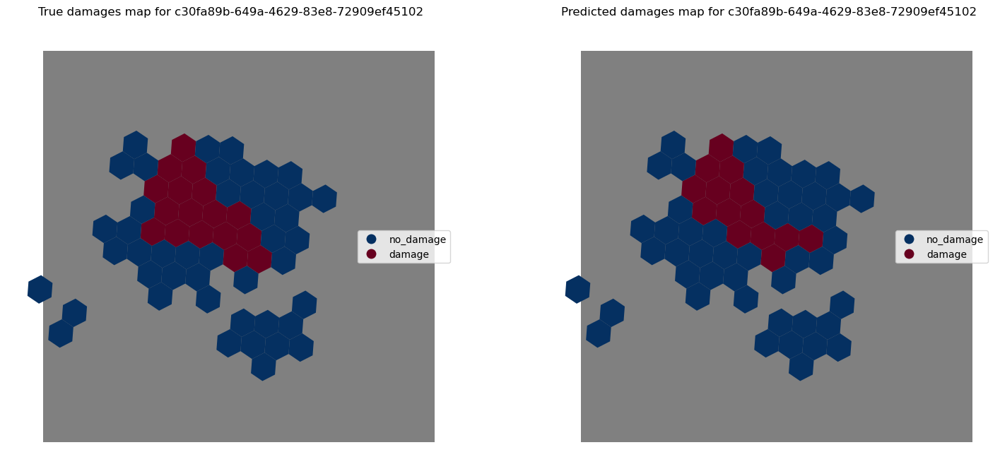

In [386]:
metrics, urban_zs_pred, urban_zs_label, plots = res.values()
rs_a = rioxr.open_rasterio(a_rs_path)


dict_max_f1, urban_zs_pred_binary, urban_zs_label_binary = get_binary_dm(metrics["metrics"], 
                                                                         urban_zs_pred, 
                                                                         urban_zs_label, 
                                                                         metric_ref="f1_score")

plots["fig_dm_binary"] = visualize_damage_map_binary(
                            urban_zs_pred=urban_zs_pred_binary, 
                            bounds = rs_a.rio.bounds(), 
                            urban_zs_label=urban_zs_label_binary, 
                            img_id=img_id,
)

In [377]:
dict_max_f1

{'precision': 0.9285714285714286,
 'recall': 0.7647058823529411,
 'f1_score': 0.8387096774193549,
 'kappa_score': 0.7856154910096819,
 'roc_auc_score': 0.8712418300653594,
 'AP': 0.7746001626457035,
 'th': 0.42}

In [393]:
train.shape[0] / train.model_name.nunique()

15.0

6

### Binary th

In [34]:
def get_binary_dm(metrics, urban_zs_pred, urban_zs_label, metric_ref):
    
    metrics = metrics.set_index("th")
    th = metrics[metric_ref].idxmax()
    th_true = 0
    
    max_metrics_associated = metrics.loc[th, :].values.squeeze()
    dict_max_f1 = dict(zip(metrics.columns, max_metrics_associated))
    dict_max_f1["th"] = th
    
    urban_zs_pred_binary = urban_zs_pred.copy()
    urban_zs_pred_binary["sum"] = (urban_zs_pred_binary["sum"] > th)
    
    urban_zs_label_binary = urban_zs_label.copy()
    urban_zs_label_binary["sum"] = (urban_zs_label_binary["sum"] > th_true)
    return dict_max_f1, urban_zs_pred_binary, urban_zs_label_binary

In [385]:
def visualize_damage_map_binary(urban_zs_pred, 
                         bounds: Tuple[float], 
                         urban_zs_label=None, 
                         img_id=None,
                        viz_name:str=None):

    x_min, y_min, x_max, y_max = bounds
    background = gpd.GeoDataFrame(geometry=[box(x_min, y_min, x_max, y_max)], crs=urban_zs_label.crs)

    legend_kwds={"labels": ["no_damage", "damage"], "loc":"center right"}

    if urban_zs_label is None:
        fig, axes = plt.subplots(1, 1, figsize=(15, 6))
        urban_zs_label.plot(column='sum',cmap="RdBu_r", legend=True, figsize=(15, 5), ax=axes, legend_kwds=legend_kwds)
        plt.axis("off")
        plt.title(f"Damages map for {img_id}" if img_id else "Damages map")
        background.plot(color="grey", zorder=0, ax=axes)

    else:
        fig, axes = plt.subplots(1, 2, figsize=(18, 8))
        urban_zs_label.plot(column='sum', cmap="RdBu_r", legend=True, ax=axes[0], legend_kwds=legend_kwds)
        axes[0].set_axis_off()
        axes[0].set_title(f"True damages map for {img_id}" if img_id else "True damages map")
        background.plot(ax=axes[0], color="grey", zorder=0)
        #axes[0].legend(loc="center right")


        urban_zs_pred.plot(column='sum',cmap="RdBu_r", legend=True, ax=axes[1], legend_kwds=legend_kwds)
        axes[1].set_axis_off()
        axes[1].set_title(f"Predicted damages map for {img_id}" if img_id else "Predicted damages map")
        background.plot(ax=axes[1], color="grey", zorder=0)

    return fig

```python
img_id = sample.img_id

s_buffer = 157
save= True
method = "osm_buffer"
fill_holes=True
resolution=12
building_buffer=7

label_path = sample.labels_path

        
town_name, loc, b_rs_path, a_rs_path = dataset.loc[dataset.img_id == img_id, ["town_name", "geometry", "before_path", "after_path"]].values.squeeze()

#rs_b = rioxr.open_rasterio(b_rs_path)
#data_b = rs_b.data.transpose(1, 2, 0)
rs_a = rioxr.open_rasterio(a_rs_path)


urban_path = extract_urban_area(name=town_name,
                              before_rs_path=b_rs_path, 
                              loc=loc, 
                              method_seg=method,
                              fill_holes=fill_holes,
                              resolution=resolution,
                              building_buffer=building_buffer)

print(f"== hex {resolution} - {building_buffer} ==")
    

res = eval_on_sample(output=output, 
                         label_path=label_path, 
                         a_path=a_rs_path,
                         img_id=img_id,
                         urban_path=urban_path, 
                         visualize=False)

metrics, urban_zs_pred, urban_zs_label, plots = res.values()

dict_max_f1, urban_zs_pred_binary, urban_zs_label_binary = get_binary_dm(metrics["metrics"], 
                                                                         urban_zs_pred, 
                                                                         urban_zs_label, 
                                                                         metric_ref="f1_score")


fig_dm_binary = visualize_damage_map_binary(urban_zs_pred=urban_zs_pred_binary, 
                         bounds = rs_a.rio.bounds(), 
                         urban_zs_label=urban_zs_label_binary, 
                         img_id=img_id)

pp.pprint(dict_max_f1)





----

### Eval Dataset Labelled

In [106]:
def pipeline_eval_sample(model_name:str,
    sample: gpd.GeoSeries, 
    s_buffer: int,
    method: str,
    fill_holes: bool,
    resolution: int,
    building_buffer: int, 
    save:bool=False):

    sample_pred = sample[["before_path_png", "after_path_png", "labels_path", "img_id"]].rename({"before_path_png":"before_path", "after_path_png":"after_path"})
    
    output = inference_on_sample(sample_pred, model_name=model_name)

    img_id, town_name, loc, b_rs_path, a_rs_path, label_path = sample[["img_id", "town_name", "geometry", "before_path", "after_path", "labels_path"]].values.squeeze()

    
    out_dir = check_dir(results_dir_path, model_name , "dm", "labelled", img_id)

    rs_a = rioxr.open_rasterio(a_rs_path)

    urban_path = extract_urban_area(name=town_name,
                                  before_rs_path=b_rs_path, 
                                  loc=loc, 
                                  method_seg=method,
                                  fill_holes=fill_holes,
                                  resolution=resolution,
                                  building_buffer=building_buffer)
    
    #print(f"== hex {resolution} - {building_buffer} ==")
    res = eval_on_sample(output=output, 
                    label_path=label_path, 
                    a_path=a_rs_path,
                    img_id=img_id,
                    urban_path=urban_path, 
                    visualize=False)
    
    metrics, urban_zs_pred, urban_zs_label, plots = res.values()
    
    dict_max_f1, urban_zs_pred_binary, urban_zs_label_binary = get_binary_dm(metrics["metrics"], 
                                                                             urban_zs_pred, 
                                                                             urban_zs_label, 
                                                                             metric_ref="f1_score")
    
    plots["fig_dm_binary"] = visualize_damage_map_binary(
                                urban_zs_pred=urban_zs_pred_binary, 
                                bounds = rs_a.rio.bounds(), 
                                urban_zs_label=urban_zs_label_binary, 
                                img_id=img_id,
    )

    # format return

    pred = dict(pred=urban_zs_pred, pred_binary=urban_zs_pred_binary)
    label = dict(label=urban_zs_label, label_binary=urban_zs_label_binary)

    res = dict(metrics=metrics, 
               pred=pred, 
               label=label, 
               plots=plots,
               sample=sample, 
               resume=dict_max_f1,
               output=output,
    )

    if save:

        out_path = make_path(f'results_{img_id}.pkl', out_dir)
        save_pickle(res, out_path)
        res["plots"]["fig_dm_binary"].savefig(make_path(f"damage_map_{img_id}.png", out_dir))
        res = out_path
    
    #pp.pprint(dict_max_f1)

    return res

In [72]:
dataset.before_path.values[:2]

array(['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e.tif',
       '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/7c6e421b-866a-4ef4-b8b4-0cbbedacd46d.tif'],
      dtype=object)

In [233]:
MODELS_VERSION

{'Unet': {'1': '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/models/model_Unet_augm_default_sb32_sp96_st0.2_ep15'},
 'FC-Siam-diff': {'1': '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/models/model_FC-Siam-diff_augm_default_sb32_sp96_st0.2_ep15'},
 'FC-Siam-conc': {'1': '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/models/ model_FC-Siam-conc_augm_default_sb32_sp96_st0.2_ep15'},
 'FresUNet': {'1': '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/models/model_FresUNet_augm_default_sb32_sp96_st0.2_ep15'},
 'changeos': {'1': None},
 'cva': {'1': None}}

#### Run Pipeline

In [235]:
import warnings
from sklearn.exceptions import UndefinedMetricWarning

warnings.filterwarnings('ignore')

s_buffer = 157
save= True
method = "osm_buffer"
fill_holes=True
resolution=12
building_buffer=7

results = []

model_name = "FC-Siam-conc"
version = "1"

models_entry = init_models_entry()
models_entry[model_name]["path"] = MODELS_VERSION[model_name][version]

cnt=0
ds = pd.merge(dataset, dataset_labelled[['annotation_id', 'labels_path', 'img_id']], on="img_id", how="inner")

plt.ioff()

for i, row in tqdm(ds.iterrows(), total=len(ds)): 
    #if cnt == 1: break
    results.append(
        pipeline_eval_sample(
            model_name=model_name,
            sample=row, 
            s_buffer=s_buffer,
            method=method,
            fill_holes=fill_holes,
            resolution=resolution,
            building_buffer=building_buffer, 
            save=save)
    )
    cnt+=1

100%|███████████████████████████████████████████████████| 29/29 [01:08<00:00,  2.37s/it]


In [231]:
model_name

'FC-Siam-diff'

In [85]:
MODELS_VERSION.keys()

dict_keys(['Unet', 'FC-Siam-diff', 'FC-Siam-conc', 'FresUNet', 'changeos', 'cva'])

In [37]:
ds = pd.merge(dataset, dataset_labelled[['annotation_id', 'labels_path', 'img_id']], on="img_id", how="inner")

In [36]:
def get_perf_model(model_name, out_dir): 
    avg_scores_micro = {}
    no_label = 0
    for i, img_id in enumerate(os.listdir(out_dir)): 
        img_path = make_path(f"results_{img_id}.pkl", out_dir, img_id)
        res = load_pickle(img_path)

        # check if label exists 
        label = res["label"]["label_binary"]
        if label["sum"].sum() == 0: 
            no_label+=1
            #continue
    
        for k,v in res["resume"].items():
            if k in avg_scores_micro:
                avg_scores_micro[k].append(v)
            else:
                avg_scores_micro[k] =  [v]
    pp.pprint({k:np.mean(v) for k,v in avg_scores_micro.items()})
    print(f"no label : {no_label}")
    return avg_scores_micro

In [58]:
train_ds = load_pickle(make_path(f"dataset_labelled_train_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))
train_ds.shape

(15, 5)

In [ ]:
%%time
# get perf based on platform 

f1_list = {}
no_label = 0
result_dir = make_path("labelled", results_dir_path, "{}", "dm")

train_ds = load_pickle(make_path(f"dataset_labelled_train_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))
test_ds = load_pickle(make_path(f"dataset_labelled_test_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

train_ds_id = list(train_ds.img_id)
test_ds_id = list(test_ds.img_id)

#model_name="FresUNet"
platforms = []
#out_dir=result_dir.format(model_name)

train_scores = []

dict_scores = {}

for model_name in tqdm(MODELS_VERSION, total=len(MODELS_VERSION)): 
    
    out_dir=result_dir.format(model_name)
    dict_scores[model_name] = {}
    
    for i, img_id in enumerate(os.listdir(out_dir)):
        #if i==1: break
        img_path = make_path(f"results_{img_id}.pkl", out_dir, img_id)
        res = load_pickle(img_path)
        plt_ = '_'.join(res["sample"][["before_platform", "after_platform"]].values.squeeze()) 
        
        label_p = True if isinstance(res["sample"]["labels_path"], str) else False 
    
        label_ = (res["label"]["label_binary"]["sum"])
        pred_ = (res["pred"]["pred_binary"]["sum"])

        n_pos = len(label_[label_ > 0])
        n_neg = len(label_[label_ == 0])

        n_pos_pred = len(pred_[pred_ > 0])
        n_neg_pred = len(pred_[pred_ == 0])
    
        if res["sample"]["img_id"] in train_ds_id: train_= True
        elif res["sample"]["img_id"] in test_ds_id: train_= False
        else: train_= np.nan
    
        platforms.append(
            (
                model_name,
                img_id,
                plt_, 
                res["resume"]["th"],
                res["resume"]["f1_score"],
                res["resume"]["precision"],
                res["resume"]["recall"],
                label_p, 
                train_, 
                res["sample"]["labels_path"], 
                n_pos, 
                n_neg,
                n_pos_pred, 
                n_neg_pred
            ))
    
        dict_scores[model_name][img_id] = res["resume"]
    
platforms = pd.DataFrame(platforms, columns=["model_name","img_id","plt","th", "f1_score","precision","recall", "label", "train", "label_path", "n_pos", "n_neg", "n_pos_pred", "n_neg_pred"])

In [119]:
platforms.groupby("model_name").agg({"f1_score":["mean", "std"],"precision":["mean", "std"],"recall":["mean", "std"]})

f1_score           precision              recall          
                  mean       std      mean       std      mean       std
model_name                                                              
FC-Siam-conc  0.405144  0.367696  0.436231  0.418287  0.444444  0.400299
FC-Siam-diff  0.389898  0.345854  0.394572  0.371846  0.464031  0.408286
FresUNet      0.441482  0.386305  0.447950  0.410953  0.471962  0.411275
Unet          0.392649  0.351276  0.409040  0.384651  0.443781  0.394101
changeos      0.067419  0.157555  0.136814  0.314045  0.048963  0.121184
cva           0.357310  0.332463  0.308755  0.312623  0.499910  0.435428

In [171]:
scores_tot = platforms[~platforms.train.isna()].groupby("model_name").agg({"precision":"mean","recall":"mean","f1_score":"mean"})

scores_train = platforms[platforms.train == True].groupby("model_name").agg({"precision":"mean","recall":"mean","f1_score":"mean"})

scores_test = platforms[platforms.train == False].groupby("model_name").agg({"precision":"mean","recall":"mean","f1_score":"mean"}).reset_index()

In [183]:
tot = platforms[~platforms.train.isna()]
tot[tot.model_name == "FresUNet"].th.median()

0.37

In [175]:
platforms[platforms.train == True]

,model_name,img_id,plt,th,f1_score,precision,recall,label,train,label_path,n_pos,n_neg
3,Unet,8e7cdfe0-8423-49a9-88d0-643584beb4ea,WV03_WV02,0.54,0.764706,0.641975,0.945455,True,True,/home/rustt/Documents/Projects/building_damage...,55,39
4,Unet,3d2355ab-f7b9-4e01-8cb0-0926b0158fd6,WV03_WV02,0.58,0.756757,0.700000,0.823529,True,True,/home/rustt/Documents/Projects/building_damage...,34,29
6,Unet,06c5f930-99be-4350-92ac-83ec3f5fc66d,WV03_WV02,0.00,0.857143,0.762712,0.978261,True,True,/home/rustt/Documents/Projects/building_damage...,46,14
7,Unet,8e56d520-c7f6-4e10-b9ed-08412ef3d120,WV03_WV03,0.32,0.222222,0.125000,1.000000,True,True,/home/rustt/Documents/Projects/building_damage...,3,31
8,Unet,2db3a8c0-d73c-4882-bee4-6feebf069345,WV03_WV02,0.96,0.400000,0.500000,0.333333,True,True,/home/rustt/Documents/Projects/building_damage...,3,66
...,...,...,...,...,...,...,...,...,...,...,...,...
168,cva,acd6b1ca-6b84-4694-8ed3-8df918d7f843,WV03_WV02,0.70,0.266667,0.153846,1.000000,True,True,/home/rustt/Documents/Projects/building_damage...,2,27
169,cva,6452d33d-48c3-4c46-99a5-61e044217e09,WV03_WV02,0.34,0.791667,0.703704,0.904762,True,True,/home/rustt/Documents/Projects/building_damage...,21,11
171,cva,6871c09a-b170-43af-bfed-d51d7d158f90,WV03_WV02,0.64,0.428571,0.272727,1.000000,True,True,/home/rustt/Documents/Projects/building_damage...,3,21
172,cva,2f661e17-7e85-409c-a4c4-a22ee62cf250,WV03_WV02,0.96,0.444444,0.500000,0.400000,True,True,/home/rustt/Documents/Projects/building_damage...,10,58


In [174]:
platforms[platforms.train == False]

,model_name,img_id,plt,th,f1_score,precision,recall,label,train,label_path,n_pos,n_neg
1,Unet,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.70,0.750000,1.000000,0.600000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27
2,Unet,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.30,0.750000,0.642857,0.900000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11
10,Unet,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.68,0.687500,0.733333,0.647059,True,False,/home/rustt/Documents/Projects/building_damage...,17,45
30,FC-Siam-diff,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.72,0.666667,0.750000,0.600000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27
31,FC-Siam-diff,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.82,0.705882,0.857143,0.600000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11
39,FC-Siam-diff,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.80,0.666667,0.687500,0.647059,True,False,/home/rustt/Documents/Projects/building_damage...,17,45
59,FC-Siam-conc,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.44,0.888889,1.000000,0.800000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27
60,FC-Siam-conc,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.00,0.666667,0.500000,1.000000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11
68,FC-Siam-conc,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.36,0.774194,0.857143,0.705882,True,False,/home/rustt/Documents/Projects/building_damage...,17,45
88,FresUNet,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.44,0.800000,0.666667,1.000000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27


In [173]:
scores_tot.head()

,precision,recall,f1_score
model_name,,,
FC-Siam-conc,0.702817,0.716048,0.652732
FC-Siam-diff,0.635700,0.747606,0.628169
FresUNet,0.721698,0.760383,0.711276
Unet,0.659008,0.714980,0.632602
changeos,0.220422,0.078885,0.108619


In [172]:
scores_test

,model_name,precision,recall,f1_score
0,FC-Siam-conc,0.785714,0.835294,0.776583
1,FC-Siam-diff,0.764881,0.615686,0.679739
2,FresUNet,0.740079,0.921569,0.802647
3,Unet,0.792063,0.715686,0.729167
4,changeos,0.208333,0.166667,0.185185
5,cva,0.469783,0.766667,0.550277


Text(0.5, 1.0, 'Evaluation des modèles (macro avg)')

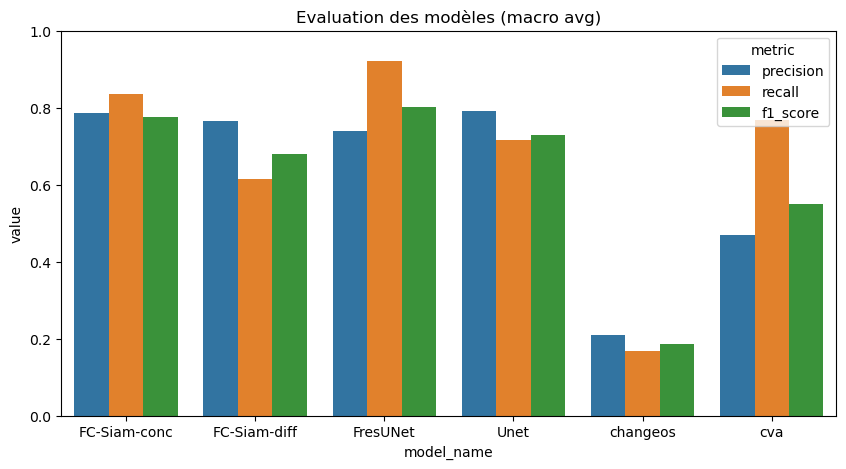

In [163]:
plot_test = scores_test.melt(id_vars="model_name", var_name="metric")
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.barplot(plot_test, x="model_name", y="value", hue="metric", ax=ax)
ax.set_ylim([0, 1])
ax.set_title("Evaluation des modèles (macro avg)")
#ax.errorbar(data=x, x='Group', y='Mean', yerr='SD', ls='', lw=3, color='black')

### Micro avg

micro vs macro https://datascience.stackexchange.com/questions/15989/micro-average-vs-macro-average-performance-in-a-multiclass-classification-settin

extract global best th (and not the optimal one for every img)

In [ ]:
# get th global

f1_list = {}
no_label = 0
result_dir = make_path("labelled", results_dir_path, "{}", "dm")

train_ds = load_pickle(make_path(f"dataset_labelled_train_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))
test_ds = load_pickle(make_path(f"dataset_labelled_test_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

train_ds_id = list(train_ds.img_id)
test_ds_id = list(test_ds.img_id)

#model_name="FresUNet"
#platforms = []
#out_dir=result_dir.format(model_name)

train_scores = []

dict_scores = {}

th_list = np.arange(0, 1.02, 0.02)


for model_name in tqdm(MODELS_VERSION, total=len(MODELS_VERSION)): 
    
    out_dir=result_dir.format(model_name)
    dict_scores[model_name] = {}

    
    for i, img_id in enumerate(os.listdir(out_dir)):
        dict_scores[model_name][img_id] = {}        
        #if i==1: break
        img_path = make_path(f"results_{img_id}.pkl", out_dir, img_id)
        res = load_pickle(img_path)

        label = list(res["label"]["label_binary"]["sum"])
        pred = list(res["pred"]["pred"]["sum"])

        for th in th_list:
            dict_scores[model_name][img_id][th] = {"tp":0, "fp":0, "tn":0, "fn":0}
            pred_ = pred.copy()
            
            pred_binary = (pred_ > th).astype(int)
            
            for i,true_v in enumerate(label): 
                if true_v == 1: 
                    if pred_binary[i] == 1: 
                        dict_scores[model_name][img_id][th]["tp"] += 1 
                    else:
                        dict_scores[model_name][img_id][th]["fn"] += 1 
                elif pred_binary[i] == 1: 
                    dict_scores[model_name][img_id][th]["fp"] +=1
                else:
                    dict_scores[model_name][img_id][th]["tn"] +=1

In [82]:
# total
bmicro_scores_tot = []

prec_track = []
track= []
precision_th = {}
recall_th = {}
f1_th = {}
results_th = {}
for model_name, m in dict_scores.items():
    
    precision_th = {}
    recall_th = {}
    f1_th = {}
    results_th[model_name] = {}
    
    df_m = pd.DataFrame(m.values())

    for img_id, th_d in m.items(): 
        
        for th, d in th_d.items(): 
            if th in d: 
                results_th[model_name][th] = {k:v+d[k] for k,v  in results_th[model_name][th].items()}
            else:
                results_th[model_name][th] = {k:v for k,v  in d.items()}

      
    for th, d in results_th[model_name].items(): 
        precision_th[th] = d["tp"] / (d["tp"] + d["fp"]) if (d["tp"] + d["fp"]) > 0 else 0
        recall_th[th] = d["tp"] / (d["tp"] + d["fn"]) if (d["tp"] + d["fn"]) > 0 else 0
        f1_th[th] = (2*precision_th[th]*recall_th[th])/(precision_th[th] + recall_th[th]) if (precision_th[th] + recall_th[th]) > 0 else 0

    prec_track.append(precision_th)
    
    scores = pd.DataFrame(
            zip(
                th_list,
                list(dict(sorted(precision_th.items(), key=lambda x: x[0])).values()), 
                list(dict(sorted(recall_th.items(), key=lambda x: x[0])).values()), 
                list(dict(sorted(f1_th.items(), key=lambda x: x[0])).values())
            ), 
        columns=["th", "precision", "recall", "f1"]
    )
    scores["model_name"] = model_name
    
    track.append(scores)

    idx_max = scores["f1"].idxmax()

    bmicro_scores_tot.append(scores.iloc[idx_max].values)

bmicro_scores_tot = pd.DataFrame(bmicro_scores_tot, columns=["th", "precision", "recall", "f1", "model_name"])
bmicro_scores_tot

,th,precision,recall,f1,model_name
0,0.74,0.884615,0.696970,0.779661,Unet
1,0.72,0.682927,0.848485,0.756757,FC-Siam-diff
2,0.34,0.714286,0.909091,0.800000,FC-Siam-conc
3,0.34,0.769231,0.909091,0.833333,FresUNet
4,0.00,0.750000,0.181818,0.292683,changeos
5,0.74,0.540984,1.000000,0.702128,cva


In [60]:
bmicro_scores_test = []

prec_track = []
track= []
precision_th = {}
recall_th = {}
f1_th = {}
results_th = {}

train_ds = load_pickle(make_path(f"dataset_labelled_train_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))
test_ds = load_pickle(make_path(f"dataset_labelled_test_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

train_ds_id = list(train_ds.img_id)
test_ds_id = list(test_ds.img_id)


for model_name, m in dict_scores.items():
    
    precision_th = {}
    recall_th = {}
    f1_th = {}
    results_th[model_name] = {}
    switch=0

    
    df_m = pd.DataFrame(m.values())

    for img_id, th_d in m.items(): 
        if img_id not in test_ds_id:
            switch +=1
            continue
        
        for th, d in th_d.items(): 
            if th in d: 
                results_th[model_name][th] = {k:v+d[k] for k,v  in results_th[model_name][th].items()}
            else:
                results_th[model_name][th] = {k:v for k,v  in d.items()}

      
    for th, d in results_th[model_name].items(): 
        precision_th[th] = d["tp"] / (d["tp"] + d["fp"]) if (d["tp"] + d["fp"]) > 0 else 0
        recall_th[th] = d["tp"] / (d["tp"] + d["fn"]) if (d["tp"] + d["fn"]) > 0 else 0
        f1_th[th] = (2*precision_th[th]*recall_th[th])/(precision_th[th] + recall_th[th]) if (precision_th[th] + recall_th[th]) > 0 else 0

    prec_track.append(precision_th)
    
    scores = pd.DataFrame(
            zip(
                th_list,
                list(dict(sorted(precision_th.items(), key=lambda x: x[0])).values()), 
                list(dict(sorted(recall_th.items(), key=lambda x: x[0])).values()), 
                list(dict(sorted(f1_th.items(), key=lambda x: x[0])).values())
            ), 
        columns=["th", "precision", "recall", "f1"]
    )
    scores["model_name"] = model_name
    
    track.append(scores)

    idx_max = scores["f1"].idxmax()

    bmicro_scores_test.append(scores.iloc[idx_max].values)

bmicro_scores_test = pd.DataFrame(bmicro_scores_test, columns=["th", "precision", "recall", "f1", "model_name"])
bmicro_scores_test

,th,precision,recall,f1,model_name
0,0.68,0.733333,0.647059,0.687500,Unet
1,0.80,0.687500,0.647059,0.666667,FC-Siam-diff
2,0.36,0.857143,0.705882,0.774194,FC-Siam-conc
3,0.42,0.928571,0.764706,0.838710,FresUNet
4,0.00,0.000000,0.000000,0.000000,changeos
5,0.54,0.288136,1.000000,0.447368,cva


In [50]:
len(dataset_labelled) - len(test_ds)

26

Text(0.5, 0, '')

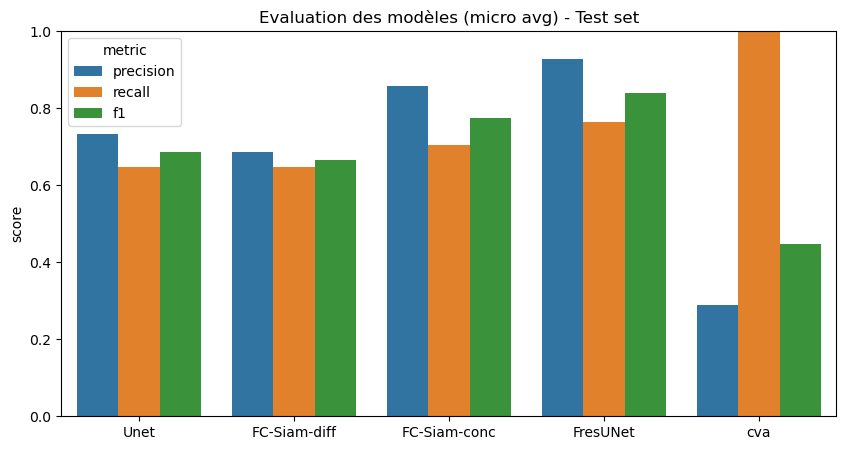

In [88]:
bmicro_scores_test = bmicro_scores_test[bmicro_scores_test.model_name !="changeos"]

plot_test_micro = bmicro_scores_test.drop("th", axis=1).melt(id_vars="model_name", var_name="metric")
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.barplot(plot_test_micro, x="model_name", y="value", hue="metric", ax=ax)
ax.set_ylim([0, 1])
ax.set_title("Evaluation des modèles (micro avg) - Test set")
ax.set_ylabel("score")
ax.set_xlabel("")

In [ ]:
bmicro_scores_test = bmicro_scores_test[bmicro_scores_test.model_name !="changeos"]

plot_test_micro = bmicro_scores_test.drop("th", axis=1).melt(id_vars="model_name", var_name="metric")
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.barplot(plot_test_micro, x="model_name", y="value", hue="metric", ax=ax)
ax.set_ylim([0, 1])
ax.set_title("Evaluation des modèles (micro avg) - Test set")
ax.set_ylabel("score")
ax.set_xlabel("")

### biais perf

In [ ]:
# get perf based on platform 

f1_list = {}
no_label = 0
result_dir = make_path("labelled", results_dir_path, "{}", "dm")

train_ds = load_pickle(make_path(f"dataset_labelled_train_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))
test_ds = load_pickle(make_path(f"dataset_labelled_test_0.2.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

train_ds_id = list(train_ds.img_id)
test_ds_id = list(test_ds.img_id)

#model_name="FresUNet"
#platforms = []
#out_dir=result_dir.format(model_name)

train_scores = []

dict_scores = {}

for model_name in tqdm(MODELS_VERSION, total=len(MODELS_VERSION)): 
    
    out_dir=result_dir.format(model_name)
    dict_scores[model_name] = {}
    
    for i, img_id in enumerate(os.listdir(out_dir)):
        dict_scores[model_name][img_id] = {"tp":0, "fp":0, "tn":0, "fn":0}
        
        #if i==1: break
        img_path = make_path(f"results_{img_id}.pkl", out_dir, img_id)
        res = load_pickle(img_path)
        #plt_ = '_'.join(res["sample"][["before_platform", "after_platform"]].values.squeeze()) 
        
        #label_p = True if isinstance(res["sample"]["labels_path"], str) else False 

        
        label = list(res["label"]["label_binary"]["sum"])
        pred = list(res["pred"]["pred_binary"]["sum"])


        for i,true_v in enumerate(label): 
            if true_v == 1: 
                if pred[i] == 1: 
                    dict_scores[model_name][img_id]["tp"] += 1 
                else:
                    dict_scores[model_name][img_id]["fn"] += 1 
            elif pred[i] == 1: 
                dict_scores[model_name][img_id]["fp"] +=1
            else:
                dict_scores[model_name][img_id]["tn"] +=1
        

In [86]:
# from previous
tot = platforms[~platforms.train.isna()]
train = platforms[platforms.train == True]
test = platforms[platforms.train == False]

In [87]:
test

,model_name,img_id,plt,th,f1_score,precision,recall,label,train,label_path,n_pos,n_neg,n_pos_pred,n_neg_pred
1,Unet,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.70,0.750000,1.000000,0.600000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27,6,31
2,Unet,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.30,0.750000,0.642857,0.900000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11,14,7
10,Unet,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.68,0.687500,0.733333,0.647059,True,False,/home/rustt/Documents/Projects/building_damage...,17,45,15,47
30,FC-Siam-diff,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.72,0.666667,0.750000,0.600000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27,8,29
31,FC-Siam-diff,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.82,0.705882,0.857143,0.600000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11,7,14
39,FC-Siam-diff,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.80,0.666667,0.687500,0.647059,True,False,/home/rustt/Documents/Projects/building_damage...,17,45,16,46
59,FC-Siam-conc,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.44,0.888889,1.000000,0.800000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27,8,29
60,FC-Siam-conc,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.00,0.666667,0.500000,1.000000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11,20,1
68,FC-Siam-conc,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.36,0.774194,0.857143,0.705882,True,False,/home/rustt/Documents/Projects/building_damage...,17,45,14,48
88,FresUNet,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.44,0.800000,0.666667,1.000000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27,15,22


In [69]:
test[["n_pos", "n_neg"]].sum()

n_pos    222
n_neg    498
dtype: int64

In [167]:
train[["n_pos", "n_neg"]].sum()

n_pos    1656
n_neg    2946
dtype: int64

In [73]:
micro_scores_tot = []
for model_name, m in dict_scores.items():

    df_m = pd.DataFrame(m.values())
    
    precision = df_m["tp"].sum() / (df_m["tp"].sum() + df_m["fp"].sum())
    recall = df_m["tp"].sum() / (df_m["fn"].sum() + df_m["tp"].sum())
    f1 = (2*precision*recall)/(precision + recall) if (precision + recall) > 0 else 0
    
    micro_scores_tot.append((model_name, precision, recall, f1))
micro_scores_tot = pd.DataFrame(micro_scores_tot, columns=["model_name", "precision", "recall", "f1"])

In [74]:
micro_scores_tot

,model_name,precision,recall,f1
0,Unet,0.268139,0.814696,0.403481
1,FC-Siam-diff,0.268342,0.853035,0.408257
2,FC-Siam-conc,0.282632,0.837061,0.422581
3,FresUNet,0.289011,0.840256,0.430090
4,changeos,0.733333,0.140575,0.235925
5,cva,0.261838,0.900958,0.405755


In [75]:
micro_scores_cut = []

for model_name, dm in dict_scores.items():
    m = {k:v for k,v in dm.items() if k in list(tot.img_id)}
    
    df_m = pd.DataFrame(m.values())
    precision = df_m["tp"].sum() / (df_m["tp"].sum() + df_m["fp"].sum())
    recall = df_m["tp"].sum() / (df_m["fn"].sum() + df_m["tp"].sum())
    f1 = (2*precision*recall)/(precision + recall) if (precision + recall) > 0 else 0
    
    micro_scores_cut.append((model_name, precision, recall, f1))
micro_scores_cut = pd.DataFrame(micro_scores_cut, columns=["model_name", "precision", "recall", "f1"])

In [76]:
micro_scores_cut

,model_name,precision,recall,f1
0,Unet,0.607143,0.814696,0.695771
1,FC-Siam-diff,0.575431,0.853035,0.687259
2,FC-Siam-conc,0.661616,0.837061,0.739069
3,FresUNet,0.693931,0.840256,0.760116
4,changeos,0.733333,0.140575,0.235925
5,cva,0.516484,0.900958,0.656577


In [77]:
micro_scores_train = []

for model_name, dm in dict_scores.items():
    m = {k:v for k,v in dm.items() if k in list(train.img_id)}
    
    df_m = pd.DataFrame(m.values())
    
    precision = df_m["tp"].sum() / (df_m["tp"].sum() + df_m["fp"].sum())
    recall = df_m["tp"].sum() / (df_m["fn"].sum() + df_m["tp"].sum())
    f1 = (2*precision*recall)/(precision + recall) if (precision + recall) > 0 else 0
    
    micro_scores_train.append((model_name, precision, recall, f1))
micro_scores_train = pd.DataFrame(micro_scores_train, columns=["model_name", "precision", "recall", "f1"])

In [78]:
micro_scores_train

,model_name,precision,recall,f1
0,Unet,0.594805,0.829710,0.692890
1,FC-Siam-diff,0.563510,0.884058,0.688293
2,FC-Siam-conc,0.655367,0.840580,0.736508
3,FresUNet,0.688623,0.833333,0.754098
4,changeos,0.750000,0.141304,0.237805
5,cva,0.543103,0.913043,0.681081


In [79]:
micro_scores_test = []

for model_name, dm in dict_scores.items():
    m = {k:v for k,v in dm.items() if k in list(test.img_id)}
    
    df_m = pd.DataFrame(m.values())
    
    precision = df_m["tp"].sum() / (df_m["tp"].sum() + df_m["fp"].sum())
    recall = df_m["tp"].sum() / (df_m["fn"].sum() + df_m["tp"].sum())
    f1 = (2*precision*recall)/(precision + recall) if (precision + recall) > 0 else 0
    
    micro_scores_test.append((model_name, precision, recall, f1))
micro_scores_test = pd.DataFrame(micro_scores_test, columns=["model_name", "precision", "recall", "f1"])

In [80]:
micro_scores_test

,model_name,precision,recall,f1
0,Unet,0.742857,0.702703,0.722222
1,FC-Siam-diff,0.741935,0.621622,0.676471
2,FC-Siam-conc,0.714286,0.810811,0.759494
3,FresUNet,0.733333,0.891892,0.804878
4,changeos,0.625000,0.135135,0.222222
5,cva,0.365854,0.810811,0.504202


Text(0.5, 1.0, 'Evaluation des modèles (micro avg) - Train set')

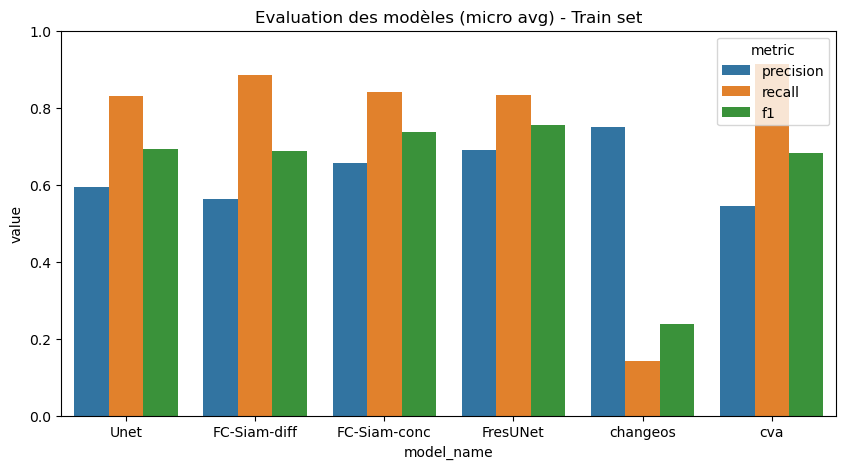

In [160]:
plot_train_micro = micro_scores_train.melt(id_vars="model_name", var_name="metric")
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.barplot(plot_train_micro, x="model_name", y="value", hue="metric", ax=ax)
ax.set_ylim([0, 1])
ax.set_title("Evaluation des modèles (micro avg) - Train set")

Text(0.5, 0, '')

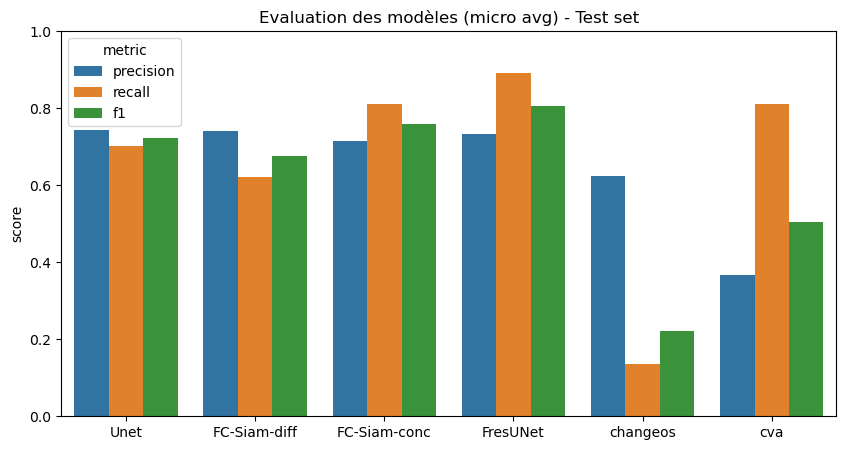

In [440]:
plot_test_micro = micro_scores_test.melt(id_vars="model_name", var_name="metric")
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.barplot(plot_test_micro, x="model_name", y="value", hue="metric", ax=ax)
ax.set_ylim([0, 1])
ax.set_title("Evaluation des modèles (micro avg) - Test set")
ax.set_ylabel("score")
ax.set_xlabel("")

In [441]:
test

,model_name,img_id,plt,f1_score,precision,recall,label,train,label_path,n_pos,n_neg
1,Unet,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.750000,1.000000,0.600000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27
2,Unet,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.750000,0.642857,0.900000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11
10,Unet,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.687500,0.733333,0.647059,True,False,/home/rustt/Documents/Projects/building_damage...,17,45
30,FC-Siam-diff,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.666667,0.750000,0.600000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27
31,FC-Siam-diff,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.705882,0.857143,0.600000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11
39,FC-Siam-diff,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.666667,0.687500,0.647059,True,False,/home/rustt/Documents/Projects/building_damage...,17,45
59,FC-Siam-conc,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.888889,1.000000,0.800000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27
60,FC-Siam-conc,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.666667,0.500000,1.000000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11
68,FC-Siam-conc,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.774194,0.857143,0.705882,True,False,/home/rustt/Documents/Projects/building_damage...,17,45
88,FresUNet,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.800000,0.666667,1.000000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27


In [444]:
train[train.model_name == "Unet"].plt.value_counts()

plt
WV03_WV02    13
WV03_WV03     2
Name: count, dtype: int64

In [446]:
train[train.model_name == "Unet"]

,model_name,img_id,plt,f1_score,precision,recall,label,train,label_path,n_pos,n_neg
3,Unet,8e7cdfe0-8423-49a9-88d0-643584beb4ea,WV03_WV02,0.764706,0.641975,0.945455,True,True,/home/rustt/Documents/Projects/building_damage...,55,39
4,Unet,3d2355ab-f7b9-4e01-8cb0-0926b0158fd6,WV03_WV02,0.756757,0.700000,0.823529,True,True,/home/rustt/Documents/Projects/building_damage...,34,29
6,Unet,06c5f930-99be-4350-92ac-83ec3f5fc66d,WV03_WV02,0.857143,0.762712,0.978261,True,True,/home/rustt/Documents/Projects/building_damage...,46,14
7,Unet,8e56d520-c7f6-4e10-b9ed-08412ef3d120,WV03_WV03,0.222222,0.125000,1.000000,True,True,/home/rustt/Documents/Projects/building_damage...,3,31
8,Unet,2db3a8c0-d73c-4882-bee4-6feebf069345,WV03_WV02,0.400000,0.500000,0.333333,True,True,/home/rustt/Documents/Projects/building_damage...,3,66
11,Unet,ae30f79d-95be-4894-8e51-afd02e4b96c6,WV03_WV02,0.666667,0.666667,0.666667,True,True,/home/rustt/Documents/Projects/building_damage...,3,1
13,Unet,d31052d1-ca71-48e0-9eb5-1212c3ab4684,WV03_WV02,0.285714,0.173913,0.800000,True,True,/home/rustt/Documents/Projects/building_damage...,10,70
15,Unet,09c5a1c8-2e13-478a-bb1f-4af9277a0e8c,WV03_WV03,0.883721,0.791667,1.000000,True,True,/home/rustt/Documents/Projects/building_damage...,19,7
21,Unet,49a91dea-ed40-4772-b6b9-f9683509b8ac,WV03_WV02,0.736842,0.700000,0.777778,True,True,/home/rustt/Documents/Projects/building_damage...,18,26
22,Unet,7c6e421b-866a-4ef4-b8b4-0cbbedacd46d,WV03_WV02,0.545455,0.529412,0.562500,True,True,/home/rustt/Documents/Projects/building_damage...,16,53


3 positif label ?? surmeent une erreur de labellisation / validtaion sur Label Studio

In [438]:
micro_scores_test

,model_name,precision,recall,f1
0,Unet,0.742857,0.702703,0.722222
1,FC-Siam-diff,0.741935,0.621622,0.676471
2,FC-Siam-conc,0.714286,0.810811,0.759494
3,FresUNet,0.733333,0.891892,0.804878
4,changeos,0.625000,0.135135,0.222222
5,cva,0.365854,0.810811,0.504202


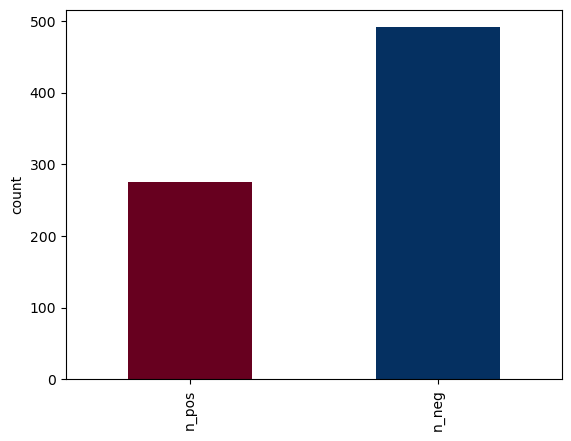

In [437]:
train[train.model_name == model_name][["n_pos", "n_neg"]].sum().plot(kind="bar", color=['#67001f', '#053061'])
plt.ylabel("count")
x = plt.xticks()
labels = ["damage", "no_damage"]
#plt.xticks_label(x, labels, rotation=90)

(array([0, 1]), [Text(0, 0, 'n_pos'), Text(1, 0, 'n_neg')])

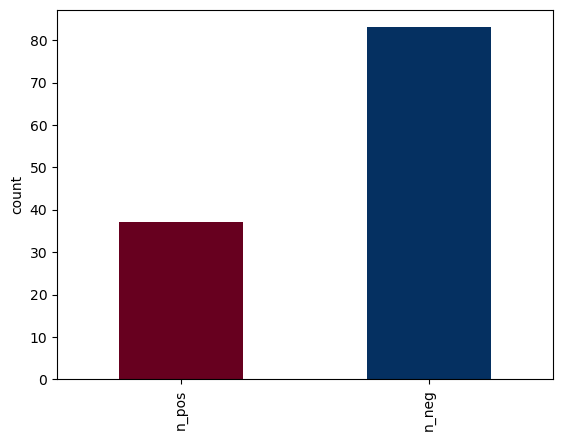

In [89]:
test[test.model_name == model_name][["n_pos", "n_neg"]].sum().plot(kind="bar", color=['#67001f', '#053061'])
plt.ylabel("count")
plt.xticks(rotation=90)

In [90]:
test[test.model_name == model_name][["n_pos", "n_neg"]].sum()

n_pos    37
n_neg    83
dtype: int64

In [91]:
37/83

0.4457831325301205

In [414]:
import matplotlib

cmap = matplotlib.cm.get_cmap('RdBu_r')
# Choose colormap
N=2
cmap = plt.cm.get_cmap('RdBu_r', N)
colors = [matplotlib.colors.to_hex(cmap(i)) for i in range(N)]

In [415]:
colors

['#053061', '#67001f']

In [407]:
test[test.model_name == model_name][["n_pos", "n_neg"]].sum().to_frame().reset_index()

,index,0
0,n_pos,37
1,n_neg,83


In [83]:
platforms[platforms.train == False]

,img_id,plt,f1_score,precision,recall,label,train,label_path,n_pos,n_neg
1,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.800000,0.666667,1.000000,True,False,/home/rustt/Documents/Projects/building_damage...,10,27
2,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.769231,0.625000,1.000000,True,False,/home/rustt/Documents/Projects/building_damage...,10,11
10,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.838710,0.928571,0.764706,True,False,/home/rustt/Documents/Projects/building_damage...,17,45


In [137]:
train = platforms[platforms.train == True]
train

AttributeError: 'list' object has no attribute 'train'

#### Notes
* nombre de sample train et test : nombre cellules
* scores (bar plots) par modèles : que labelled
    * seulement wv02-wv03
    * tout 

In [62]:
platforms[platforms.plt == "WV03_WV02"]

,img_id,plt,f1_score,label,train
0,bc3a9c2a-f14e-4516-8703-2cec72063f60,WV03_WV02,0.000000,False,NaN
1,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,WV03_WV02,0.800000,True,False
2,465955c3-57fd-4b53-b347-1e9ea61d26d7,WV03_WV02,0.769231,True,False
3,8e7cdfe0-8423-49a9-88d0-643584beb4ea,WV03_WV02,0.779412,True,True
4,3d2355ab-f7b9-4e01-8cb0-0926b0158fd6,WV03_WV02,0.769231,True,True
5,b70b24f3-d7e8-4674-b4d6-a14409743e40,WV03_WV02,0.000000,False,NaN
6,06c5f930-99be-4350-92ac-83ec3f5fc66d,WV03_WV02,0.865385,True,True
8,2db3a8c0-d73c-4882-bee4-6feebf069345,WV03_WV02,0.571429,True,True
10,c30fa89b-649a-4629-83e8-72909ef45102,WV03_WV02,0.838710,True,False
11,ae30f79d-95be-4894-8e51-afd02e4b96c6,WV03_WV02,1.000000,True,True


In [54]:
platforms[platforms.plt == "WV03_WV03"]

,plt,f1_score
7,WV03_WV03,0.222222
9,WV03_WV03,0.000000
12,WV03_WV03,0.000000
14,WV03_WV03,0.000000
15,WV03_WV03,0.926829
17,WV03_WV03,0.000000
18,WV03_WV03,0.000000
19,WV03_WV03,0.000000
25,WV03_WV03,0.000000


In [46]:
res["resume"]

{'precision': 0.0,
 'recall': 0.0,
 'f1_score': 0.0,
 'kappa_score': 0.0,
 'roc_auc_score': nan,
 'AP': -0.0,
 'th': 0.0}

In [44]:
res.keys()

dict_keys(['metrics', 'pred', 'label', 'plots', 'sample', 'resume', 'output'])

In [45]:
'_'.join(res["sample"][["before_platform", "after_platform"]].values.squeeze())

before_path                    /home/rustt/Documents/Projects/building_damage...
after_path                     /home/rustt/Documents/Projects/building_damage...
town_name                                                                    102
geometry                            POINT (572713.4379458291 3410334.0300461347)
quadkey                                                             120202021312
before_href                    https://maxar-opendata.s3.amazonaws.com/events...
before_view_off_nadir                                                       26.5
before_view_azimuth                                                   136.699997
before_view_incidence_angle                                                 60.7
before_view_sun_azimuth                                                    106.4
before_view_sun_elevation                                                   70.2
before_platform                                                             WV03
before_clouds_percent       

In [ ]:
ds

In [88]:
result_dir = make_path("labelled", results_dir_path, "{}", "dm")

model_name="changeos"
print(f"=== model {model_name} ===")
res_cva = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))


=== model changeos ===
{'AP': 0.5437755658451084,
 'f1_score': 0.5869759394107349,
 'kappa_score': 0.14979951802079544,
 'precision': 0.5638299140473053,
 'recall': 0.6853519756144605,
 'roc_auc_score': 0.5769694980945348,
 'th': 0.12600000000000003}
no label : 10


In [225]:
result_dir = make_path("labelled", results_dir_path, "{}", "dm")

model_name="FresUNet"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))


=== model FresUNet ===
{'AP': 0.6147333636085525,
 'f1_score': 0.7112763784400157,
 'kappa_score': 0.5229686941763236,
 'precision': 0.7216978851350736,
 'recall': 0.760383380039177,
 'roc_auc_score': 0.7601606522092118,
 'th': 0.3944444444444445}
no label : 11


=== model cva ===
{'AP': 0.28444576209495764,
 'f1_score': 0.3573101282704148,
 'kappa_score': 0.15543540326226385,
 'precision': 0.3087554907069469,
 'recall': 0.4999101639656362,
 'roc_auc_score': nan,
 'th': 0.4006896551724138}
no label : 11
=== model Unet ===
{'AP': 0.33211558872480756,
 'f1_score': 0.3926494206770985,
 'kappa_score': 0.21159027922953624,
 'precision': 0.4090396957024859,
 'recall': 0.44378090907436535,
 'roc_auc_score': nan,
 'th': 0.3351724137931035}
no label : 11
=== model FC-Siam-diff ===
{'AP': 0.32671342444142104,
 'f1_score': 0.3898978721364315,
 'kappa_score': 0.21000624845515373,
 'precision': 0.39457223554190607,
 'recall': 0.46403138855498205,
 'roc_auc_score': nan,
 'th': 0.39931034482758626}
no label : 11
=== model FC-Siam-conc ===
{'AP': 0.3531251362261948,
 'f1_score': 0.40514393948843713,
 'kappa_score': 0.26804295750154533,
 'precision': 0.4362312389416307,
 'recall': 0.4444436429574473,
 'roc_auc_score': nan,
 'th': 0.2579310344827586}
no label : 

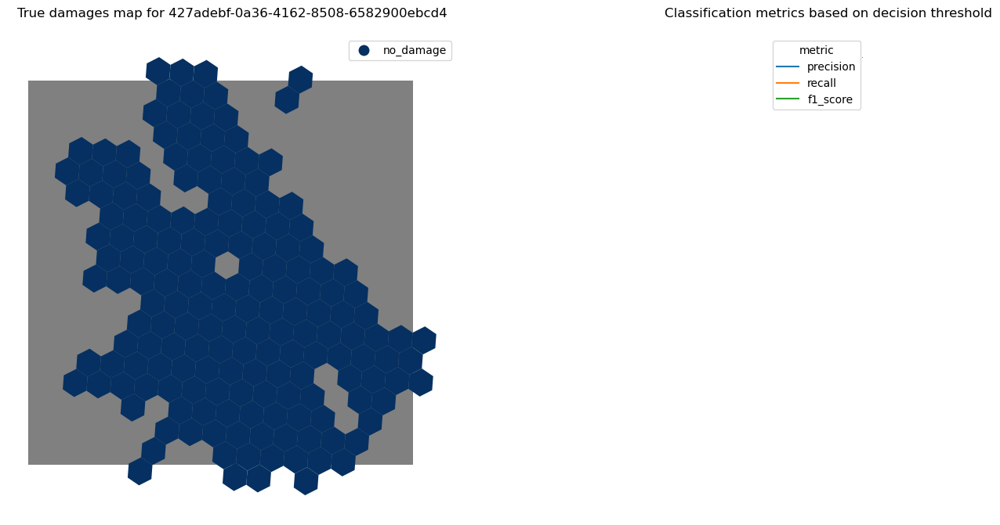

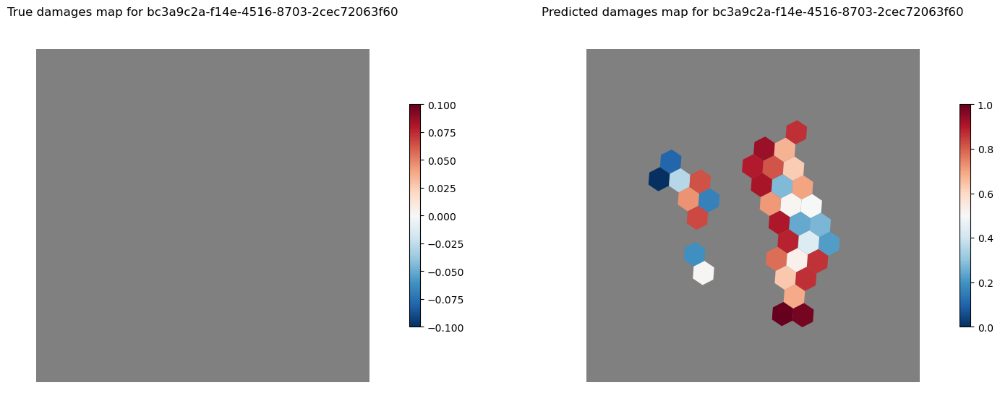

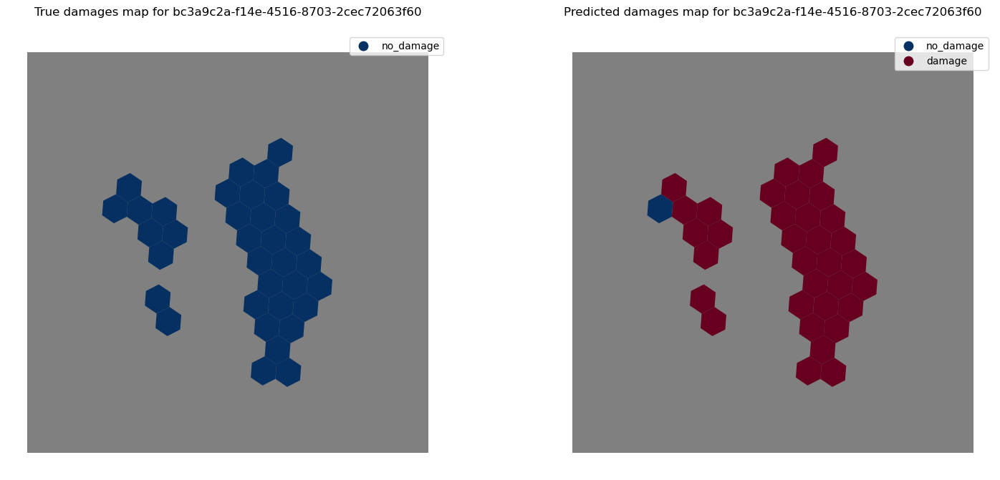

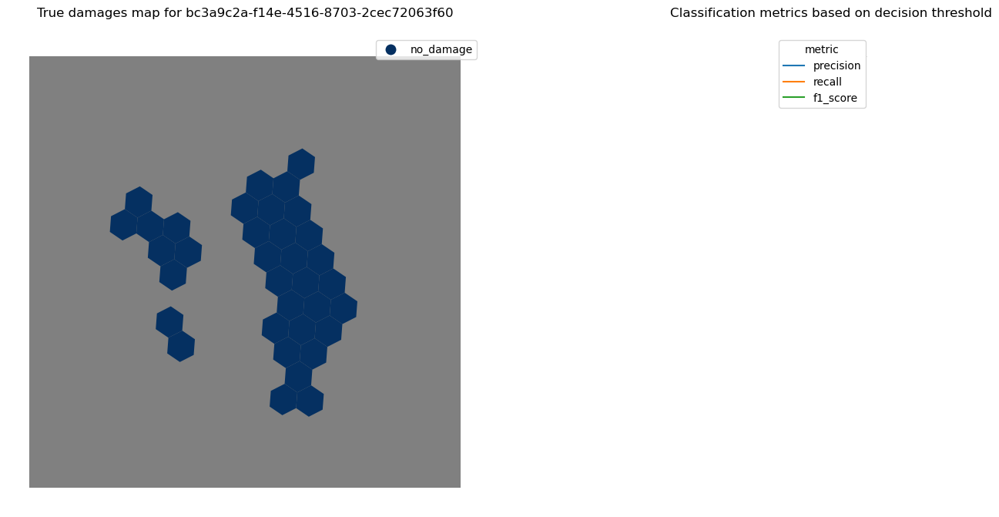

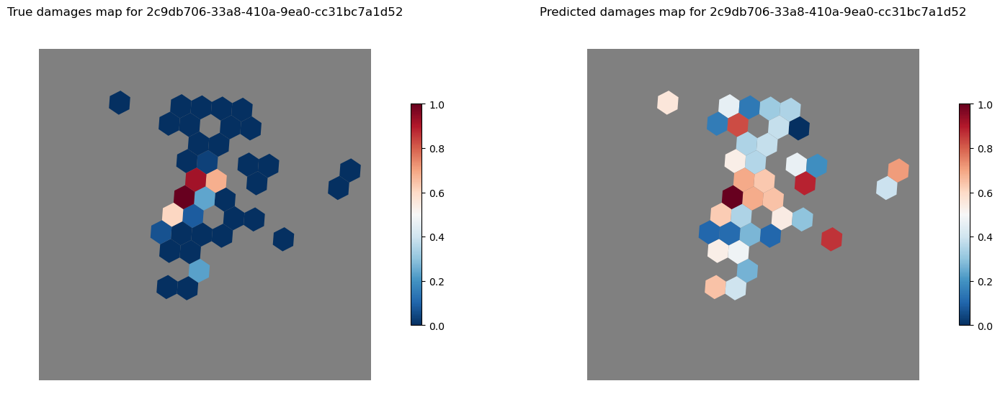

...

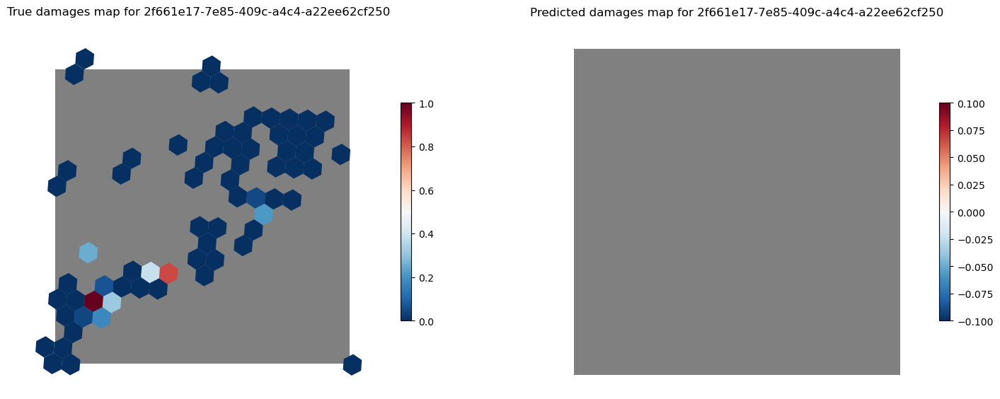

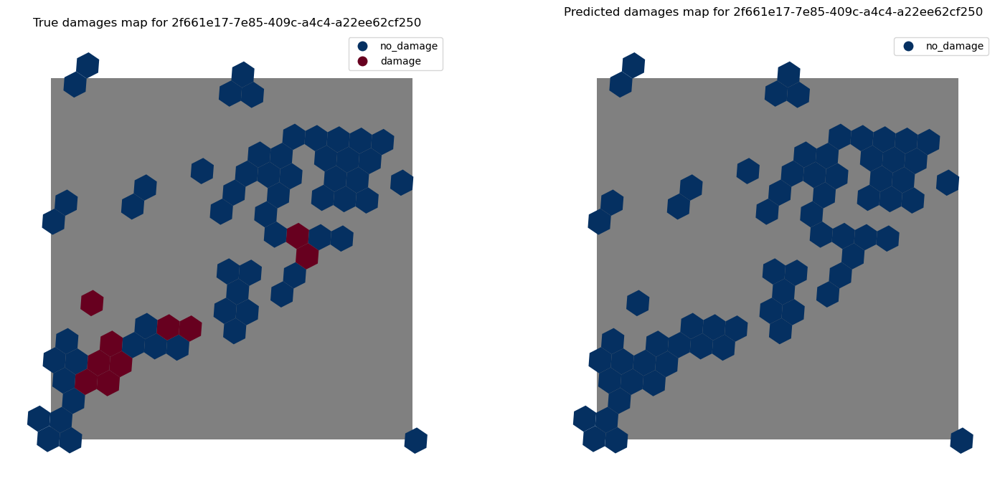

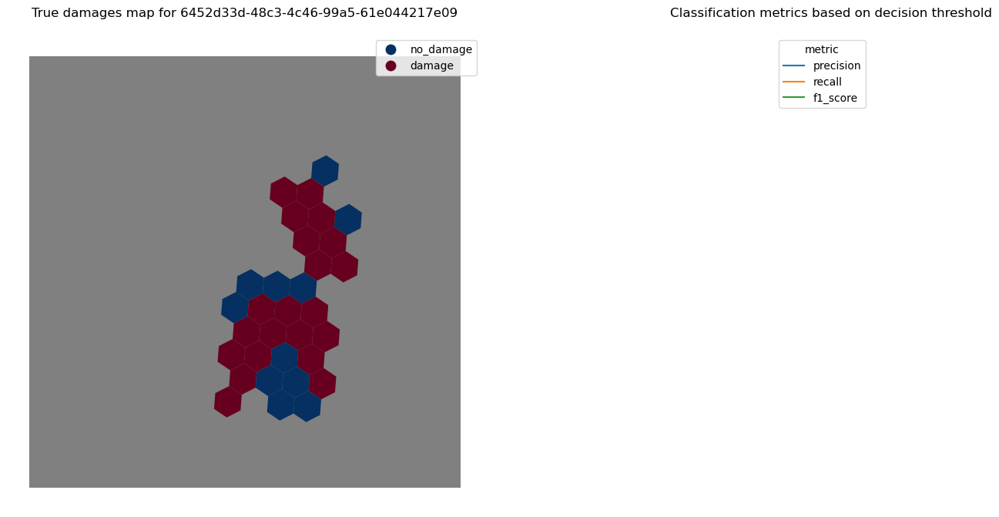

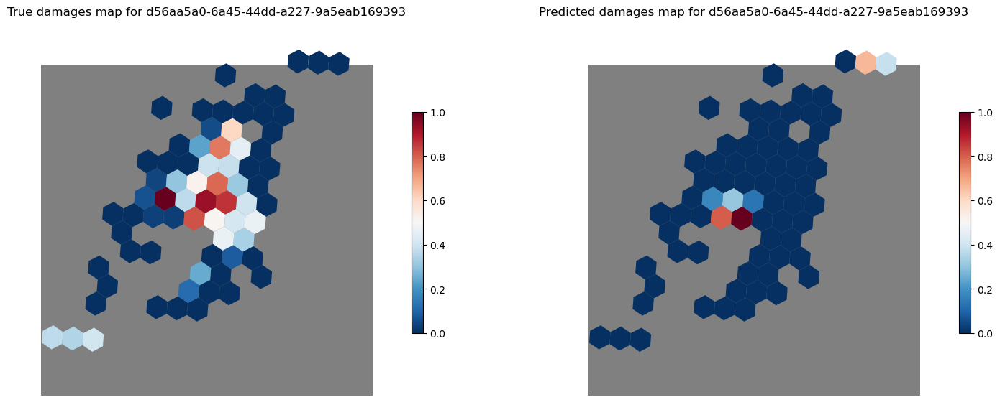

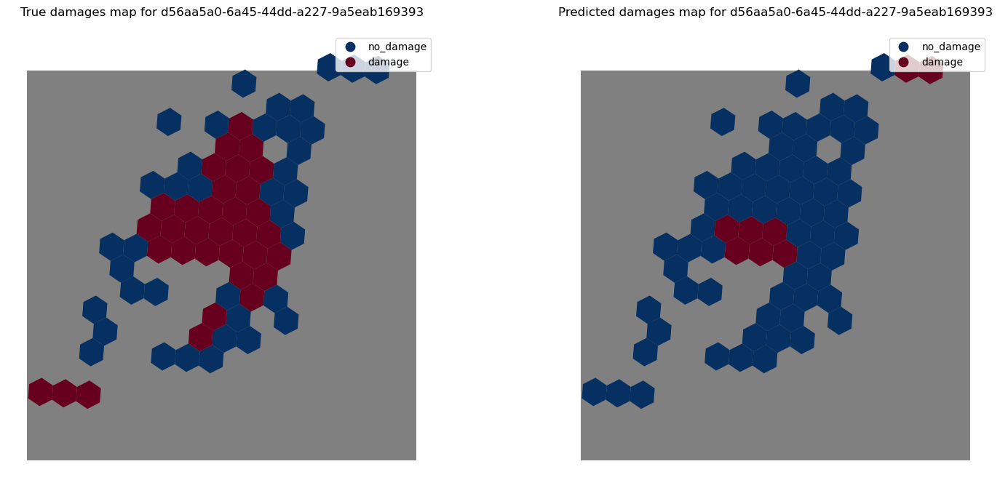

In [108]:
# new full 
result_dir = make_path("labelled", results_dir_path, "{}", "dm")

model_name="cva"
print(f"=== model {model_name} ===")
res_cva = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="Unet"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="FC-Siam-diff"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="FC-Siam-conc"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="FresUNet"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="changeos"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

* 427
* 718
* enlever wv03-wv03

In [109]:
list(dataset_labelled.img_id)

['3d2355ab-f7b9-4e01-8cb0-0926b0158fd6',
 '06c5f930-99be-4350-92ac-83ec3f5fc66d',
 '6d34c661-ebe2-4b5a-b1ad-abcbd24ff3dd',
 '7c3769e3-97a7-493e-9689-17207e6b9129',
 '8e7cdfe0-8423-49a9-88d0-643584beb4ea',
 '8e56d520-c7f6-4e10-b9ed-08412ef3d120',
 '09c5a1c8-2e13-478a-bb1f-4af9277a0e8c',
 '41b18a5f-dc92-43e9-8339-5aca5fe31cd1',
 '49a91dea-ed40-4772-b6b9-f9683509b8ac',
 '49abea86-e8b2-46bd-b5a3-df575a54b095',
 '58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e',
 '62c5e4ea-bcf8-4290-951d-2b12ebc708fc',
 '427adebf-0a36-4162-8508-6582900ebcd4',
 '718ac8b8-7d92-44f9-be54-3f8c1be28ee8',
 '6452d33d-48c3-4c46-99a5-61e044217e09',
 '465955c3-57fd-4b53-b347-1e9ea61d26d7',
 'b70b24f3-d7e8-4674-b4d6-a14409743e40',
 'b1344a7a-fed8-460d-8b8b-d756d3228381',
 'd56aa5a0-6a45-44dd-a227-9a5eab169393',
 'd31052d1-ca71-48e0-9eb5-1212c3ab4684',
 '2c9db706-33a8-410a-9ea0-cc31bc7a1d52',
 '2db3a8c0-d73c-4882-bee4-6feebf069345',
 '2f661e17-7e85-409c-a4c4-a22ee62cf250',
 '7c6e421b-866a-4ef4-b8b4-0cbbedacd46d',
 '6871c09a-b170-

In [237]:
# new with cut
result_dir = make_path("labelled", results_dir_path, "{}", "dm")

model_name="cva"
print(f"=== model {model_name} ===")
res_cva = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="Unet"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="FC-Siam-diff"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="FC-Siam-conc"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="FresUNet"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="changeos"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

=== model cva ===
{'AP': 0.458273727819654,
 'f1_score': 0.5756663177690016,
 'kappa_score': 0.25042370525586954,
 'precision': 0.4974394016945256,
 'recall': 0.8054108197224139,
 'roc_auc_score': 0.6584058543386889,
 'th': 0.6455555555555557}
no label : 11
=== model Unet ===
{'AP': 0.5350751151677456,
 'f1_score': 0.6326018444242143,
 'kappa_score': 0.3408954498698084,
 'precision': 0.659008398631783,
 'recall': 0.7149803535086997,
 'roc_auc_score': 0.6668362320265491,
 'th': 0.5399999999999999}
no label : 11
=== model FC-Siam-diff ===
{'AP': 0.5263716282667339,
 'f1_score': 0.6281687939975842,
 'kappa_score': 0.3383434002888588,
 'precision': 0.6356997128175155,
 'recall': 0.7476061260052488,
 'roc_auc_score': 0.6767994669921568,
 'th': 0.6433333333333334}
no label : 11
=== model FC-Siam-conc ===
{'AP': 0.5689238305866472,
 'f1_score': 0.6527319025091487,
 'kappa_score': 0.43184698708582303,
 'precision': 0.7028169960726273,
 'recall': 0.7160480914314427,
 'roc_auc_score': 0.71849919

In [125]:
# old
result_dir = make_path("labelled", results_dir_path, "{}", "dm")

model_name="cva"
print(f"=== model {model_name} ===")
res_cva = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="Unet"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="FC-Siam-diff"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="FC-Siam-conc"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="FresUNet"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

model_name="changeos"
print(f"=== model {model_name} ===")
res_fresunet = get_perf_model(model_name=model_name, out_dir=result_dir.format(model_name))

=== model cva ===
{'AP': 0.48375436483487244,
 'f1_score': 0.6161971468216494,
 'kappa_score': -0.011683886390347143,
 'precision': 0.48946004732049425,
 'recall': 0.8796073225767668,
 'roc_auc_score': 0.5058783392985452,
 'th': 0.084}
=== model Unet ===
{'AP': 0.6274630621981542,
 'f1_score': 0.7163375257190794,
 'kappa_score': 0.3933166726693088,
 'precision': 0.6626579191461606,
 'recall': 0.8822408225477278,
 'roc_auc_score': 0.7086809125566298,
 'th': 0.4}
=== model FC-Siam-diff ===
{'AP': 0.6068137725622841,
 'f1_score': 0.711217397100943,
 'kappa_score': 0.3670093997056473,
 'precision': 0.6319105353064319,
 'recall': 0.8546837391082915,
 'roc_auc_score': 0.6973111432014827,
 'th': 0.45600000000000007}
=== model FC-Siam-conc ===
{'AP': 0.6195858937776239,
 'f1_score': 0.7218524319883015,
 'kappa_score': 0.40656270281886603,
 'precision': 0.6487824115309715,
 'recall': 0.878700376066105,
 'roc_auc_score': 0.7169366471996298,
 'th': 0.364}
=== model FresUNet ===
{'AP': 0.628800447

In [76]:
model_name = "cva"

out_dir = check_dir(results_dir_path, model_name, "dm", "labelled")
avg_scores_micro = {}
for img_id in os.listdir(out_dir): 
    img_path = make_path(f"results_{img_id}.pkl", out_dir, img_id)
    res = load_pickle(img_path)

    for k,v in res["resume"].items():
        if k in avg_scores_micro:
            avg_scores_micro[k].append(v)
        else:
            avg_scores_micro[k] =  [v]

In [77]:
avg_scores_micro["f1_score"]

[0.6428571428571429,
 0.753623188405797,
 0.6875,
 0.0,
 0.8761904761904762,
 0.4,
 0.0,
 0.0,
 0.31034482758620696,
 0.0,
 0.8181818181818181,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.5614035087719298,
 0.8235294117647058,
 0.0,
 0.6407766990291262]

In [78]:
pp.pprint({k:np.mean(v) for k,v in avg_scores_micro.items()})

{'AP': 0.2571433418553969,
 'f1_score': 0.32572035363936014,
 'kappa_score': 0.04937859987165248,
 'precision': 0.27138050436233246,
 'recall': 0.44428167120117584,
 'roc_auc_score': nan,
 'th': 0.069}


In [79]:
pp.pprint({k:np.mean([_ for _ in v if _>0]) for k,v in avg_scores_micro.items()})

{'AP': 0.5142866837107939,
 'f1_score': 0.6514407072787203,
 'kappa_score': 0.13642454181661826,
 'precision': 0.5427610087246649,
 'recall': 0.8885633424023517,
 'roc_auc_score': 0.5539063023707985,
 'th': 0.23}


7c3769e

In [220]:
res = load_pickle("test.pkl")
urban, arr, rs = res.values()

In [223]:
arr

array([[0.05256456, 0.03714991, 0.02076781, ..., 0.15251875, 0.14127201,
        0.2241289 ],
       [0.02321899, 0.02231783, 0.00897282, ..., 0.15193659, 0.11840159,
        0.14176768],
       [0.03183383, 0.01529419, 0.00796294, ..., 0.14409357, 0.15971506,
        0.17326474],
       ...,
       [0.01434225, 0.01295596, 0.00749022, ..., 0.07048339, 0.06610852,
        0.06694829],
       [0.06602222, 0.03208637, 0.0315094 , ..., 0.12138307, 0.14905334,
        0.14156139],
       [0.08183944, 0.03195959, 0.04312712, ..., 0.10587454, 0.15751791,
        0.10383499]], dtype=float32)

In [222]:
urban.crs

<Projected CRS: EPSG:32629>
Name: WGS 84 / UTM zone 29N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 12°W and 6°W, northern hemisphere between equator and 84°N, onshore and offshore. Algeria. Côte D'Ivoire (Ivory Coast). Faroe Islands. Guinea. Ireland. Jan Mayen. Mali. Mauritania. Morocco. Portugal. Sierra Leone. Spain. United Kingdom (UK). Western Sahara.
- bounds: (-12.0, 0.0, -6.0, 84.0)
Coordinate Operation:
- name: UTM zone 29N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [224]:
rs.rio.transform()

Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0)

In [70]:
metrics.head(2)

,precision,recall,f1_score,kappa_score,roc_auc_score,AP
th,,,,,,
0.00,0.315992,1.0,0.480234,0.017166,0.513699,0.315992
0.02,0.335378,1.0,0.502297,0.070902,0.554795,0.335378
